# Branin Experiment

In [1]:
# Imports
from typing import Callable

import equinox as eqx
import jax
import jax.numpy as jnp
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import optax
import particles.distributions as dists
from IPython.display import HTML
from jax import random
from jaxtyping import Array, Integer, PRNGKeyArray, PyTree, Real
from matplotlib.animation import FuncAnimation
from matplotlib.axes import Axes
from matplotlib.figure import Figure
from matplotlib.patches import Ellipse
from optax import GradientTransformation
from particles.core import SMC
from particles.state_space_models import GuidedPF, StateSpaceModel

In [2]:
# Constants

# Branin
A = 1
B = 5.1 / (4 * jnp.pi**2)
C = 5 / jnp.pi
R = 6
S = 10
T_BRANIN = 1 / (8 * jnp.pi)

# Plotting
MIN_X_1 = -6
MAX_X_1 = 12
MIN_X_2 = -2
MAX_X_2 = 18

# Elliptical region
ELLIPSE_CENTRE = jnp.array([-0.2, 7.5])
ELLIPSE_SEMI_AXES = jnp.array([3.6, 8.0])
ELLIPSE_ANGLE_DEG = 25
ELLIPSE_ANGLE_RAD = jnp.deg2rad(ELLIPSE_ANGLE_DEG)

# Training
NUM_SAMPLES = 6_000

# Diffusion
BETA_MIN = jnp.array(0.0001)
BETA_MAX = jnp.array(0.02)
T = jnp.array(1000)

In [3]:
# Config
key = random.PRNGKey(100)
matplotlib.rcParams["animation.embed_limit"] = 2**128

Consider the Branin function:
$$
f(x_1, x_2) = a(x_2 - bx_1^2 + cx_1 - r)^2 + s(1-t)\cos(x_1) + s
$$
where $a=1$, $b = \frac{5.1}{4\pi^2}$, $c=\frac{5}{\pi}$, $r=6$, $s=10$, $t=\frac{1}{8\pi}$.
It has three global minimas located at:

- $(-\pi, 12.275)$
- $(\pi, 2.275)$
- $(9.42478, 2.475)$

with a value of $0.397887$. We plot it below over the range $(x_1, x_2) \in [-6, 12] \times [-2, 18]$:

In [4]:
# Define Branin function
def get_branin(
    a: float = A, b: float = B, c: float = C, r: float = R, s: float = S, t: float = T_BRANIN
) -> Callable[[Real[Array, "..."], Real[Array, "..."]], Real[Array, "..."]]:
    def branin(x_1: Real[Array, "..."], x_2: Real[Array, "..."]) -> Real[Array, "..."]:
        return a * (x_2 - b * x_1**2 + c * x_1 - r) ** 2 + s * (1 - t) * jnp.cos(x_1) + s

    return branin


branin = get_branin()

minima_points = jnp.array([(-jnp.pi, 12.275), (jnp.pi, 2.275), (9.42478, 2.475)])

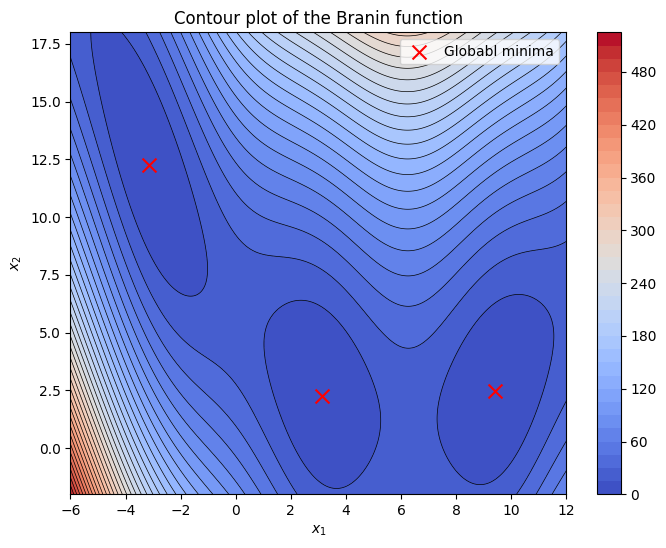

In [5]:
# Branin contour plot

# Create a grid of points
x_1_points = jnp.linspace(-6, 12, 1000)
x_2_points = jnp.linspace(-2, 18, 1000)
x_1_meshpoints, x_2_meshpoints = jnp.meshgrid(x_1_points, x_2_points)

# Evaluate the Branin function at each grid point
branin_values = branin(x_1_meshpoints, x_2_meshpoints)


def plot_branin_contour(
    x_1_meshpoints: Real[Array, "x_1 x_2"],
    x_2_meshpoints: Real[Array, "x_1 x_2"],
    branin_values: Real[Array, "x_1 x_2"],
    minima_points: Real[Array, "num_minima 2"],
) -> tuple[Figure, Axes]:
    fig, ax = plt.subplots(figsize=(8, 6))

    cp = ax.contourf(x_1_meshpoints, x_2_meshpoints, branin_values, levels=50, cmap="coolwarm")
    fig.colorbar(cp, ax=ax)

    ax.contour(
        x_1_meshpoints, x_2_meshpoints, branin_values, levels=50, colors="black", linewidths=0.5
    )

    ax.scatter(
        minima_points[:, 0],
        minima_points[:, 1],
        color="red",
        zorder=5,
        marker="x",
        s=100,
        label="Globabl minima",
    )

    ax.set_title("Contour plot of the Branin function")
    ax.set_xlabel("$x_1$")
    ax.set_ylabel("$x_2$")
    ax.set_xlim(MIN_X_1, MAX_X_1)
    ax.set_ylim(MIN_X_2, MAX_X_2)
    ax.legend()

    return fig, ax


# Use the function to plot
branin_fig, branin_ax = plot_branin_contour(
    x_1_meshpoints, x_2_meshpoints, branin_values, minima_points
)
plt.show()

Now consider some uniform prior sampling distribution over an ellipse region centered at
$(-0.2, 7.5)$ with semi-axis lengths $(3.6, 8)$, tilted $25\degree$. This region covers two of
the global minima:

- $(-\pi, 12.275)$
- $(\pi, 2.275)$

We plot this region atop the previous plot to demonstrate:

In [6]:
# Define ellipse
def get_ellipse() -> Ellipse:
    return Ellipse(
        xy=ELLIPSE_CENTRE,
        width=2 * ELLIPSE_SEMI_AXES[0],
        height=2 * ELLIPSE_SEMI_AXES[1],
        angle=ELLIPSE_ANGLE_DEG,
        edgecolor="orange",
        facecolor="none",
        linewidth=2,
        zorder=6,
        label="Prior sampling region",
    )

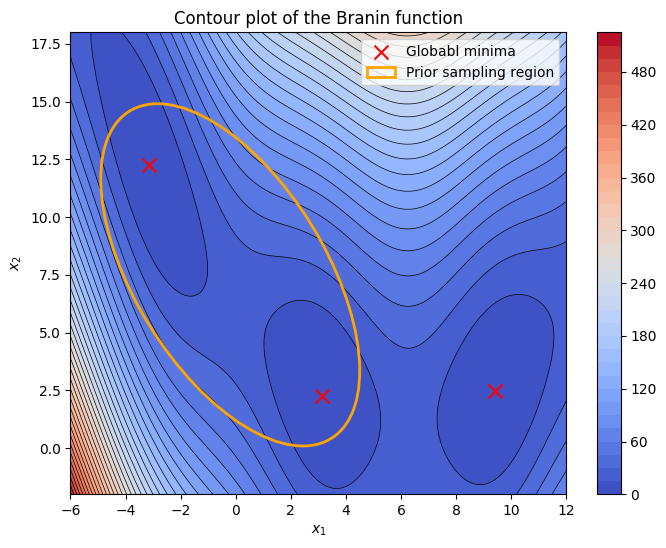

In [7]:
# Plot the points to visualize
branin_fig, branin_ax = plot_branin_contour(
    x_1_meshpoints, x_2_meshpoints, branin_values, minima_points
)
branin_ax.add_patch(get_ellipse())
branin_ax.legend()
plt.show()

Now, we train a diffusion model to sample from the prior (i.e. uniformly within the ellipse).
While sampling from this distribution is obviously straightforward, we train a diffusion model
because we can then apply guidance according to the constraints (i.e. the Branin function and the
imposed feasible region), or rather their induced Boltzman distributions.

We use 6000 data points for training; we defer tuning and validation.

In [8]:
# Generate data points
def sample_unit_circle_uniform(n: int, key: PRNGKeyArray) -> Real[Array, "..."]:
    sub_key_1, sub_key_2 = random.split(key)

    angles = random.uniform(sub_key_1, (n,), minval=0, maxval=2 * jnp.pi)
    radii = jnp.sqrt(random.uniform(sub_key_2, (n,)))
    x = radii * jnp.cos(angles)
    y = radii * jnp.sin(angles)
    return jnp.vstack((x, y)).T


def unit_circle_to_ellipse(
    unit_circle_points: Real[Array, "batch 2"],
    semi_axes: Real[Array, "2"] = ELLIPSE_SEMI_AXES,
    angle_rad: Real[Array, ""] = ELLIPSE_ANGLE_RAD,
    center: Real[Array, "2"] = ELLIPSE_CENTRE,
) -> Real[Array, "batch 2"]:
    # Scale points to the ellipse dimensions
    ellipse_points = unit_circle_points * semi_axes

    # Rotation matrix for the given angle
    rotation_matrix = jnp.array(
        [[jnp.cos(angle_rad), -jnp.sin(angle_rad)], [jnp.sin(angle_rad), jnp.cos(angle_rad)]]
    )

    # Rotate the points
    rotated_points = ellipse_points.dot(rotation_matrix.T)

    # Translate the points to the specified center
    return rotated_points + center


key, sub_key = random.split(key)
unit_circle_points = sample_unit_circle_uniform(NUM_SAMPLES, sub_key)
ellipse_points = unit_circle_to_ellipse(unit_circle_points)

Following Kong et al. (2024), we consider the variance preserving (VP) SDE:
$$
d\mathbf{x}_T = -\frac{1}{2}\beta(t)\mathbf{x}_t\,dt + \sqrt{\beta(t)}\,d\mathbf{w}_t,\quad \mathbf{x}_0 \sim p_0 = p_{data}
$$
In the discrete setting, we write the forward process as a Markov chain:
$$
q(\mathbf{x}_{1:T} \mid \mathbf{x}_0) = \prod_{t=1}^T q(\mathbf{x}_i \mid \mathbf{x}_{t-1})
$$
where
$$
\mathbf{X}_t \mid \mathbf{X}_{t-1} \sim \mathcal{N}(a_t\mathbf{x}_{t-1}, b_t^2 I_{d_x})
$$
Given the Gaussian transition, we can write:
$$
\mathbf{X}_t \mid \mathbf{X}_{0} \sim \mathcal{N}(c_t\mathbf{x}_0, d_t^2 I_{d_x})
$$
For the VP SDE:

\begin{align*}
a_t &= \sqrt{\alpha_t} \\
b_t &= \sqrt{\beta_t} \\
c_t &= \sqrt{\overline{\alpha}_t} \\
d_t &= \sqrt{1 - \overline{\alpha}_t}
\end{align*}

where

\begin{align*}
\alpha_t &:= 1 - \beta_t \\
\overline{\alpha}_t &:= \prod_{\tau=1}^t \alpha_\tau
\end{align*}


We'll use a linear noising schedule:
$$
\beta_t = \beta_{\text{min}} + t(\beta_{\text{max}} - \beta_{\text{min}})
$$
We'll consider $t \in \{0, \ldots, 1000\}$, and can examine the action of the forward noising
process:

In [9]:
# Define the diffusion
def beta_t(
    t: Real[Array, " batch"],
    beta_min: Real[Array, ""] = BETA_MIN,
    beta_max: Real[Array, ""] = BETA_MAX,
) -> Real[Array, " batch"]:
    return beta_min + t * (beta_max - beta_min) / T


def alpha_t(t: Real[Array, " batch"]) -> Real[Array, " batch"]:
    return 1 - beta_t(t)


alpha = alpha_t(jnp.arange(T + 1))
cumulative_alpha_values = jnp.cumprod(alpha)


def a_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return jnp.sqrt(alpha_t(t))


def b_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return jnp.sqrt(beta_t(t))


def c_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return jnp.sqrt(cumulative_alpha_values[t])


def d_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return jnp.sqrt(1 - cumulative_alpha_values[t])


def u_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return jnp.sqrt(alpha_t(t - 1))


def v_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return -jnp.sqrt(alpha_t(t)) * (1 - cumulative_alpha_values[t - 1])


def w_t(t: Integer[Array, " batch"]) -> Real[Array, " batch"]:
    return jnp.sqrt(
        beta_t(t) * (1 - cumulative_alpha_values[t - 1]) / (1 - cumulative_alpha_values[t])
    )


def forward_marginal(
    key: PRNGKeyArray, x_0: Real[Array, "batch dim"], t: Integer[Array, " batch"]
) -> Real[Array, "batch dim"]:
    return c_t(t) * x_0 + d_t(t) ** 2 * random.normal(key, x_0.shape)

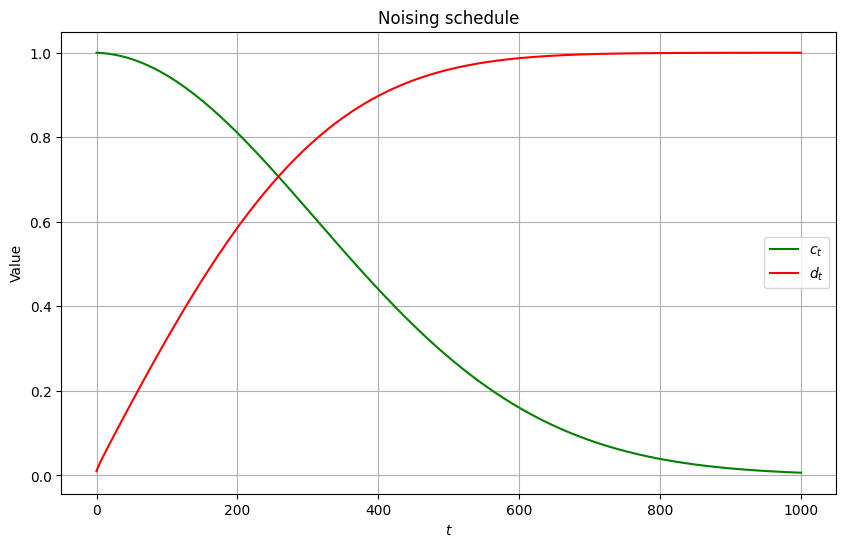

In [10]:
# Plot noising schedule
times = jnp.arange(T + 1)

plt.figure(figsize=(10, 6))

plt.plot(times, c_t(times), label="$c_t$", color="green")
plt.plot(times, d_t(times), label="$d_t$", color="red")

plt.xlabel("$t$")
plt.ylabel("Value")
plt.title("Noising schedule")
plt.legend()
plt.grid(True)
plt.show()

Next let's define and train our neural network for predicting the noise/score. We use the simple
architecture described [here](https://jakiw.com/diffusion_model_intro). We use the denoising
objective of Ho et al. (2020) rather than score-matching.

In [11]:
# Define network, loss, and training loop


class FullyConnectedWithTime(eqx.Module):
    """A simple model with multiple fully connected layers and some fourier features for the time
    variable.
    """

    layers: list[eqx.nn.Linear]

    def __init__(self, in_size: int, key: PRNGKeyArray):
        key1, key2, key3, key4 = jax.random.split(key, 4)
        out_size = in_size

        self.layers = [
            eqx.nn.Linear(in_size + 4, 256, key=key1),
            eqx.nn.Linear(256, 256, key=key2),
            eqx.nn.Linear(256, 256, key=key3),
            eqx.nn.Linear(256, out_size, key=key4),
        ]

    def __call__(self, x: Array, t: Array) -> Real[Array, "1"]:
        t_fourier = jnp.array(
            [t - 0.5, jnp.cos(2 * jnp.pi * t), jnp.sin(2 * jnp.pi * t), -jnp.cos(4 * jnp.pi * t)],
        )

        x = jnp.concatenate([x, t_fourier])

        for layer in self.layers[:-1]:
            x = jax.nn.relu(layer(x))

        x = self.layers[-1](x)

        return x


@jax.jit
@jax.value_and_grad
def loss(model: FullyConnectedWithTime, data: Array, key: PRNGKeyArray) -> Real[Array, ""]:
    key1, key2 = random.split(key, 2)

    random_times = random.randint(key1, (data.shape[0],), minval=0, maxval=T)

    # NOTE: noise will match as both use key2
    noise = random.normal(key2, data.shape)
    noised_data = forward_marginal(key2, data, random_times[:, jnp.newaxis])

    # NOTE: rescale time to in [0, 1]
    output = jax.vmap(model)(noised_data, random_times / (T - 1))

    loss = jnp.mean((noise - output) ** 2)

    return loss


def fit(
    model: FullyConnectedWithTime,
    steps: int,
    optimizer: GradientTransformation,
    data: Array,
    rng: PRNGKeyArray,
    print_every: int = 5_000,
) -> FullyConnectedWithTime:
    opt_state = optimizer.init(eqx.filter(model, eqx.is_array))
    losses: list[float] = []

    @eqx.filter_jit
    def make_step(
        model: FullyConnectedWithTime,
        opt_state: PyTree,
        data: Array,
        step_rng: PRNGKeyArray,
    ):
        loss_value, grads = loss(model, data, step_rng)
        updates, opt_state = optimizer.update(grads, opt_state, model)
        model = eqx.apply_updates(model, updates)

        return model, opt_state, loss_value

    for step in range(steps):
        step_rng, rng = random.split(rng, 2)
        model, opt_state, train_loss = make_step(
            model,
            opt_state,
            data,
            step_rng,
        )
        losses.append(train_loss)

        if (step % print_every) == 0 or (step == steps - 1):
            mean_loss = jnp.mean(jnp.array(losses))
            print(f"{step=},\t avg_train_loss={mean_loss}")

    return model

In [12]:
# Training
# NOTE: some weird bug where crashes after too many epochs; probably some Metal thing though...

n_epochs = 20_000

key, sub_key = random.split(key)
denoiser_model = FullyConnectedWithTime(2, key=sub_key)
optimizer = optax.adamw(learning_rate=1e-3)

key, sub_key = random.split(key)
fitted_model = fit(denoiser_model, n_epochs, optimizer, ellipse_points, sub_key)

step=0,	 avg_train_loss=1.0187662839889526
step=5000,	 avg_train_loss=0.45436805486679077
step=10000,	 avg_train_loss=0.4530818462371826
step=15000,	 avg_train_loss=0.45251649618148804
step=19999,	 avg_train_loss=0.45219188928604126


## Annealed Langevin

In [135]:
# Define unguided sampling function
def unguided_sampling(
    key: PRNGKeyArray, n_samples: int, model: eqx.Module, r: float = 0.1
) -> tuple[Array, np.ndarray]:
    key, sub_key = random.split(key)
    all_outputs = np.zeros((T + 1, n_samples, 2))

    # Time T
    x_t = random.normal(sub_key, (n_samples, 2))
    all_outputs[T, :, :] = x_t

    # Algorithm 5 - Song (2021)
    for t in range(T, 0, -1):
        t_vec = jnp.full((n_samples,), t / T)

        for _ in range(1):  # num langevin/corrector steps
            key, sub_key = random.split(key)

            noise_estimate = jax.vmap(model)(x_t, t_vec)
            score_estimate = -noise_estimate / d_t(t)

            z = random.normal(sub_key, (n_samples, 2))

            # NOTE: in Song $\alpha_t$ equivalent to $\overline{\alpha}_t$ in DDPM notation.
            # Hence, c_t^2 = \overline{\alpha}_t} \equiv \alpha_t
            # NOTE: using batch suggestion; straight approach seemed to not work well

            norm_score = jnp.mean(jnp.linalg.norm(score_estimate, axis=1))
            norm_z = jnp.sqrt(2)

            epsilon = 2 * c_t(t) ** 2 * (r * norm_z / norm_score) ** 2

            x_t = x_t + epsilon * score_estimate + jnp.sqrt(2 * epsilon) * z

        all_outputs[t - 1, :, :] = x_t

    return x_t, all_outputs

In [137]:
# Get unguided samples
key, sub_key = random.split(key)
n_samples = 1000
samples, all_outputs = unguided_sampling(key, n_samples, fitted_model)

fig, ax = plt.subplots(figsize=(7, 8))

ax.grid(True)
ax.set_xlim(-9, 8)
ax.set_ylim(-5, 16)
ax.set_xlabel("$x_0$")
ax.set_ylabel("$x_1$")
ax.axhline(-1, color="black")
ax.axvline(-1, color="black")
ax.add_patch(get_ellipse())

# NOTE: initial point irrelevant for scatters but matters for quiver offsets...
scat = ax.scatter(all_outputs[0, :, 0], all_outputs[0, :, 1], c="dodgerblue", s=1)


def update(t):
    ax.set_title(f"Time: {t}")
    ax.set_title(f"Reverse Process\nTime: {t}")
    scat.set_offsets(all_outputs[t])

    return (scat,)


ani = FuncAnimation(fig, update, frames=jnp.arange(T, -5, -5), interval=50, blit=True)
plt.close()

HTML(ani.to_jshtml())

## Dilation Annealed Langevin

In [29]:
# Define unguided sampling function
def linear_schedule(t):
    return max((T - t) / T, 1 / T)

def exp_schedule(t):
    # Define start and end points
    start = 1
    end = 0.0001

    # Calculate the interpolation points in the log space
    log_start = np.log(start)
    log_end = np.log(end)

    # Create a linear space between log_start and log_end
    log_space = np.linspace(log_start, log_end, T + 1)

    # Exponentiate to get the actual value at time t
    exp_value = np.exp(log_space[t])

    return exp_value

lambda_t = linear_schedule

def unguided_sampling(
    key: PRNGKeyArray, n_samples: int, model: eqx.Module, r: float = 0.15
) -> tuple[Array, np.ndarray]:
    key, sub_key = random.split(key)
    all_outputs = np.zeros((T + 1, n_samples, 2))

    # Time T
    x_t = random.normal(sub_key, (n_samples, 2))
    all_outputs[T, :, :] = x_t

    # Algorithm 5 - Song (2021)
    for t in range(T, 0, -1):
        t_vec = jnp.full((n_samples,), t / T)

        for _ in range(1):  # num langevin/corrector steps
            key, sub_key = random.split(key)

            dilated_noise_estimate = jax.vmap(model)(x_t / jnp.sqrt(lambda_t(t)), t_vec)
            dilated_score_estimate = (1 / jnp.sqrt(lambda_t(t))) * (
                -dilated_noise_estimate / d_t(t)
            )

            z = random.normal(sub_key, (n_samples, 2))

            # NOTE: in Song $\alpha_t$ equivalent to $\overline{\alpha}_t$ in DDPM notation.
            # Hence, c_t^2 = \overline{\alpha}_t} \equiv \alpha_t
            # NOTE: using batch suggestion; straight approach seemed to not work well

            norm_score = jnp.mean(jnp.linalg.norm(dilated_score_estimate, axis=1))
            norm_z = jnp.sqrt(2)

            epsilon = 2 * c_t(t) ** 2 * (r * norm_z / norm_score) ** 2
            # epsilon = 2 * (r * norm_z / norm_score) ** 2
            # epsilon = 0.01

            x_t = x_t + epsilon * dilated_score_estimate + jnp.sqrt(2 * epsilon) * z

        all_outputs[t - 1, :, :] = x_t

    return x_t, all_outputs

In [30]:
# Get unguided samples
key, sub_key = random.split(key)
n_samples = 1000
samples, all_outputs = unguided_sampling(key, n_samples, fitted_model)

# Animate reverse process
fig, ax = plt.subplots(figsize=(7, 8))

ax.grid(True)
ax.set_xlim(-9, 8)
ax.set_ylim(-5, 16)
ax.set_xlabel("$x_0$")
ax.set_ylabel("$x_1$")
ax.axhline(-1, color="black")
ax.axvline(-1, color="black")
ax.add_patch(get_ellipse())

# NOTE: initial point irrelevant for scatters but matters for quiver offsets...
scat = ax.scatter(all_outputs[0, :, 0], all_outputs[0, :, 1], c="dodgerblue", s=1)


def update(t):
    ax.set_title(f"Time: {t}")
    ax.set_title(f"Reverse Process\nTime: {t}")
    scat.set_offsets(all_outputs[t])

    return (scat,)


ani = FuncAnimation(fig, update, frames=jnp.arange(T, -5, -5), interval=50, blit=True)
plt.close()

HTML(ani.to_jshtml())